In [66]:
from sklearn.metrics import mean_squared_error
import optuna
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold

import pandas as pd
import numpy as np

from xgb_params import xgb_params

from xgboost import XGBRegressor

# Hyper Parameter Tuning

In [67]:
train_path = 'processed/processed_train_2.csv'

train_df = pd.read_csv(train_path)
y = train_df['price_doc']
X = train_df.drop(['price_doc'], axis=1)

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

def objective(trial):
    params = {
        "learning_rate": trial.suggest_float("learning_rate", 1e-3, 0.1, log=True),
        "n_estimators":  trial.suggest_int("n_estimators", 100, 1000),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        "max_depth": trial.suggest_int("max_depth", 3, 10),
        "min_child_weight": trial.suggest_int('min_child_weight', 0, 12),
        "gamma": trial.suggest_float("gamma", 0, 1),
        'rate_drop': trial.suggest_float('rate_drop', 0, 1),
        'sample_type': trial.suggest_categorical('sample_type', ['uniform', 'weighted']),
        "lambda": trial.suggest_loguniform("lambda", 1e-8, 1.0),
        "alpha": trial.suggest_loguniform("alpha", 1e-8, 1.0),
    }
    
    regressor =  XGBRegressor(
                        device=xgb_params['device'],
                        objective=xgb_params['objective'],
                        eval_metric=xgb_params['eval_metric'],
                        enable_categorical=xgb_params['enable_categorical'],
                        early_stopping_rounds=xgb_params['early_stopping_rounds'],
                        n_jobs=xgb_params['n_jobs'],
                        booster='dart',
                        **params
                )
    
    regressor.fit(X_train, y_train, eval_set=[(X_val, y_val)])
    y_pred = regressor.predict(X_val)
    rmse = mean_squared_error(y_val, y_pred, squared=False)
    return rmse


study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=20)
best_params = study.best_params

[I 2023-11-01 11:07:39,172] A new study created in memory with name: no-name-3f810a51-a4e9-485a-b707-5c691c8cb406
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is depre

[0]	validation_0-rmsle:0.61861
[1]	validation_0-rmsle:0.61464
[2]	validation_0-rmsle:0.60895


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[3]	validation_0-rmsle:0.60414
[4]	validation_0-rmsle:0.59710
[5]	validation_0-rmsle:0.59592
[6]	validation_0-rmsle:0.59198
[7]	validation_0-rmsle:0.58588
[8]	validation_0-rmsle:0.58357
[9]	validation_0-rmsle:0.57810
[10]	validation_0-rmsle:0.57452
[11]	validation_0-rmsle:0.57215
[12]	validation_0-rmsle:0.57055
[13]	validation_0-rmsle:0.56949
[14]	validation_0-rmsle:0.56859
[15]	validation_0-rmsle:0.56570
[16]	validation_0-rmsle:0.56297
[17]	validation_0-rmsle:0.56146
[18]	validation_0-rmsle:0.56057
[19]	validation_0-rmsle:0.55849
[20]	validation_0-rmsle:0.55708
[21]	validation_0-rmsle:0.55568
[22]	validation_0-rmsle:0.55425
[23]	validation_0-rmsle:0.55380
[24]	validation_0-rmsle:0.54995
[25]	validation_0-rmsle:0.54967
[26]	validation_0-rmsle:0.54789
[27]	validation_0-rmsle:0.54540
[28]	validation_0-rmsle:0.54494
[29]	validation_0-rmsle:0.54447
[30]	validation_0-rmsle:0.54338
[31]	validation_0-rmsle:0.54209
[32]	validation_0-rmsle:0.54101
[33]	validation_0-rmsle:0.54039
[34]	validation

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:11:11,437] Trial 0 finished with value: 3101808.647548904 and parameters: {'learning_rate': 0.0358782866376156, 'n_estimators': 652, 'colsample_bytree': 0.2965368374067709, 'max_depth': 4, 'min_child_weight': 9, 'gamma': 0.9783782179384007, 'rate_drop': 0.09518282422971869, 'sample_type': 'weighted', 'lambda': 5.7843914279979466e-08, 'alpha': 0.0004719265780477273}. Best is trial 0 with value: 3101808.647548904.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed 

[0]	validation_0-rmsle:0.62420


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[1]	validation_0-rmsle:0.62332
[2]	validation_0-rmsle:0.62246
[3]	validation_0-rmsle:0.62160
[4]	validation_0-rmsle:0.62075
[5]	validation_0-rmsle:0.62033
[6]	validation_0-rmsle:0.61950
[7]	validation_0-rmsle:0.61909
[8]	validation_0-rmsle:0.61842
[9]	validation_0-rmsle:0.61760
[10]	validation_0-rmsle:0.61733
[11]	validation_0-rmsle:0.61706
[12]	validation_0-rmsle:0.61686
[13]	validation_0-rmsle:0.61660
[14]	validation_0-rmsle:0.61633
[15]	validation_0-rmsle:0.61553
[16]	validation_0-rmsle:0.61514
[17]	validation_0-rmsle:0.61487
[18]	validation_0-rmsle:0.61472
[19]	validation_0-rmsle:0.61446
[20]	validation_0-rmsle:0.61419
[21]	validation_0-rmsle:0.61341
[22]	validation_0-rmsle:0.61322
[23]	validation_0-rmsle:0.61303
[24]	validation_0-rmsle:0.61283
[25]	validation_0-rmsle:0.61275
[26]	validation_0-rmsle:0.61256
[27]	validation_0-rmsle:0.61218
[28]	validation_0-rmsle:0.61203
[29]	validation_0-rmsle:0.61193
[30]	validation_0-rmsle:0.61174
[31]	validation_0-rmsle:0.61149
[32]	validation_0

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:11:36,827] Trial 1 finished with value: 4321494.385610787 and parameters: {'learning_rate': 0.0033205439726272734, 'n_estimators': 229, 'colsample_bytree': 0.9341294856442306, 'max_depth': 5, 'min_child_weight': 2, 'gamma': 0.2512990164464446, 'rate_drop': 0.17946156174177086, 'sample_type': 'uniform', 'lambda': 0.0006418943807005899, 'alpha': 1.1203302635105257e-05}. Best is trial 0 with value: 3101808.647548904.
suggest_loguniform has been deprecated in v3.0.0. This feature will be remove

[0]	validation_0-rmsle:0.62450
[1]	validation_0-rmsle:0.62391
[2]	validation_0-rmsle:0.62362
[3]	validation_0-rmsle:0.62343
[4]	validation_0-rmsle:0.62324
[5]	validation_0-rmsle:0.62309
[6]	validation_0-rmsle:0.62283
[7]	validation_0-rmsle:0.62272
[8]	validation_0-rmsle:0.62263
[9]	validation_0-rmsle:0.62254
[10]	validation_0-rmsle:0.62248
[11]	validation_0-rmsle:0.62241
[12]	validation_0-rmsle:0.62234
[13]	validation_0-rmsle:0.62227
[14]	validation_0-rmsle:0.62222
[15]	validation_0-rmsle:0.62214
[16]	validation_0-rmsle:0.62208
[17]	validation_0-rmsle:0.62202
[18]	validation_0-rmsle:0.62197
[19]	validation_0-rmsle:0.62191
[20]	validation_0-rmsle:0.62186
[21]	validation_0-rmsle:0.62182
[22]	validation_0-rmsle:0.62178
[23]	validation_0-rmsle:0.62173
[24]	validation_0-rmsle:0.62169
[25]	validation_0-rmsle:0.62166
[26]	validation_0-rmsle:0.62163
[27]	validation_0-rmsle:0.62158
[28]	validation_0-rmsle:0.62155
[29]	validation_0-rmsle:0.62152
[30]	validation_0-rmsle:0.62148
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:13:15,770] Trial 2 finished with value: 4483480.427191463 and parameters: {'learning_rate': 0.00200459429366991, 'n_estimators': 468, 'colsample_bytree': 0.8825987398302925, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.8782381582766728, 'rate_drop': 0.8512630771760912, 'sample_type': 'weighted', 'lambda': 0.002984635676394181, 'alpha': 0.0019141013967828423}. Best is trial 0 with value: 3101808.647548904.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in

[0]	validation_0-rmsle:0.62271
[1]	validation_0-rmsle:0.62042
[2]	validation_0-rmsle:0.61820
[3]	validation_0-rmsle:0.61601


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[4]	validation_0-rmsle:0.61387
[5]	validation_0-rmsle:0.61284
[6]	validation_0-rmsle:0.61129
[7]	validation_0-rmsle:0.61029
[8]	validation_0-rmsle:0.60874
[9]	validation_0-rmsle:0.60682
[10]	validation_0-rmsle:0.60586
[11]	validation_0-rmsle:0.60493
[12]	validation_0-rmsle:0.60431
[13]	validation_0-rmsle:0.60370
[14]	validation_0-rmsle:0.60323
[15]	validation_0-rmsle:0.60143
[16]	validation_0-rmsle:0.59969
[17]	validation_0-rmsle:0.59882
[18]	validation_0-rmsle:0.59847
[19]	validation_0-rmsle:0.59813
[20]	validation_0-rmsle:0.59778
[21]	validation_0-rmsle:0.59736
[22]	validation_0-rmsle:0.59711
[23]	validation_0-rmsle:0.59678
[24]	validation_0-rmsle:0.59636
[25]	validation_0-rmsle:0.59622
[26]	validation_0-rmsle:0.59594
[27]	validation_0-rmsle:0.59539
[28]	validation_0-rmsle:0.59498
[29]	validation_0-rmsle:0.59483
[30]	validation_0-rmsle:0.59456
[31]	validation_0-rmsle:0.59423
[32]	validation_0-rmsle:0.59396
[33]	validation_0-rmsle:0.59369
[34]	validation_0-rmsle:0.59337
[35]	validatio

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:13:43,674] Trial 3 finished with value: 4026001.619509216 and parameters: {'learning_rate': 0.009519694770403892, 'n_estimators': 233, 'colsample_bytree': 0.8537261376489307, 'max_depth': 4, 'min_child_weight': 11, 'gamma': 0.5118961165243543, 'rate_drop': 0.18200158729898375, 'sample_type': 'weighted', 'lambda': 9.620317606575916e-08, 'alpha': 0.06837125050826749}. Best is trial 0 with value: 3101808.647548904.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed 

[0]	validation_0-rmsle:0.62138
[1]	validation_0-rmsle:0.61927
[2]	validation_0-rmsle:0.61600
[3]	validation_0-rmsle:0.61506
[4]	validation_0-rmsle:0.61111
[5]	validation_0-rmsle:0.61064
[6]	validation_0-rmsle:0.60788
[7]	validation_0-rmsle:0.60694
[8]	validation_0-rmsle:0.60656
[9]	validation_0-rmsle:0.60580
[10]	validation_0-rmsle:0.60541
[11]	validation_0-rmsle:0.60523
[12]	validation_0-rmsle:0.60500
[13]	validation_0-rmsle:0.60475
[14]	validation_0-rmsle:0.60455
[15]	validation_0-rmsle:0.60429
[16]	validation_0-rmsle:0.60397
[17]	validation_0-rmsle:0.60378
[18]	validation_0-rmsle:0.60361
[19]	validation_0-rmsle:0.60315
[20]	validation_0-rmsle:0.60288
[21]	validation_0-rmsle:0.60267
[22]	validation_0-rmsle:0.60253
[23]	validation_0-rmsle:0.60237
[24]	validation_0-rmsle:0.60222
[25]	validation_0-rmsle:0.60208
[26]	validation_0-rmsle:0.60176
[27]	validation_0-rmsle:0.60143
[28]	validation_0-rmsle:0.60127
[29]	validation_0-rmsle:0.60117
[30]	validation_0-rmsle:0.60099
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:17:29,769] Trial 4 finished with value: 4125177.4347281707 and parameters: {'learning_rate': 0.016072878097506554, 'n_estimators': 698, 'colsample_bytree': 0.17369783849917275, 'max_depth': 7, 'min_child_weight': 5, 'gamma': 0.3623268393547028, 'rate_drop': 0.5797270598198372, 'sample_type': 'weighted', 'lambda': 0.04848148882877592, 'alpha': 3.529838421094419e-07}. Best is trial 0 with value: 3101808.647548904.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed 

[0]	validation_0-rmsle:0.61528
[1]	validation_0-rmsle:0.60699
[2]	validation_0-rmsle:0.59965
[3]	validation_0-rmsle:0.59263


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[4]	validation_0-rmsle:0.58649
[5]	validation_0-rmsle:0.58443
[6]	validation_0-rmsle:0.58038
[7]	validation_0-rmsle:0.57788
[8]	validation_0-rmsle:0.57578
[9]	validation_0-rmsle:0.57069
[10]	validation_0-rmsle:0.56974
[11]	validation_0-rmsle:0.56930
[12]	validation_0-rmsle:0.56814
[13]	validation_0-rmsle:0.56726
[14]	validation_0-rmsle:0.56675
[15]	validation_0-rmsle:0.56526
[16]	validation_0-rmsle:0.56420
[17]	validation_0-rmsle:0.56346
[18]	validation_0-rmsle:0.56297
[19]	validation_0-rmsle:0.56227
[20]	validation_0-rmsle:0.56194
[21]	validation_0-rmsle:0.56146
[22]	validation_0-rmsle:0.56126
[23]	validation_0-rmsle:0.56070
[24]	validation_0-rmsle:0.55989
[25]	validation_0-rmsle:0.55972
[26]	validation_0-rmsle:0.55925
[27]	validation_0-rmsle:0.55891
[28]	validation_0-rmsle:0.55859
[29]	validation_0-rmsle:0.55833
[30]	validation_0-rmsle:0.55790
[31]	validation_0-rmsle:0.55736
[32]	validation_0-rmsle:0.55703
[33]	validation_0-rmsle:0.55672
[34]	validation_0-rmsle:0.55620
[35]	validatio

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:19:00,557] Trial 5 finished with value: 3436013.60553348 and parameters: {'learning_rate': 0.0455700675251167, 'n_estimators': 429, 'colsample_bytree': 0.5608552787937204, 'max_depth': 3, 'min_child_weight': 2, 'gamma': 0.7565816349336901, 'rate_drop': 0.2690493117339101, 'sample_type': 'weighted', 'lambda': 0.025920163518476518, 'alpha': 9.255273395546565e-06}. Best is trial 0 with value: 3101808.647548904.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v

[0]	validation_0-rmsle:0.60245
[1]	validation_0-rmsle:0.58433
[2]	validation_0-rmsle:0.56909
[3]	validation_0-rmsle:0.55637
[4]	validation_0-rmsle:0.54499
[5]	validation_0-rmsle:0.54160
[6]	validation_0-rmsle:0.53433
[7]	validation_0-rmsle:0.52626
[8]	validation_0-rmsle:0.52071
[9]	validation_0-rmsle:0.51500
[10]	validation_0-rmsle:0.50934
[11]	validation_0-rmsle:0.50602
[12]	validation_0-rmsle:0.50458
[13]	validation_0-rmsle:0.50250
[14]	validation_0-rmsle:0.50087
[15]	validation_0-rmsle:0.49770
[16]	validation_0-rmsle:0.49528
[17]	validation_0-rmsle:0.49294
[18]	validation_0-rmsle:0.49225
[19]	validation_0-rmsle:0.49093
[20]	validation_0-rmsle:0.49031
[21]	validation_0-rmsle:0.48915
[22]	validation_0-rmsle:0.48798
[23]	validation_0-rmsle:0.48745
[24]	validation_0-rmsle:0.48645
[25]	validation_0-rmsle:0.48635
[26]	validation_0-rmsle:0.48580
[27]	validation_0-rmsle:0.48422
[28]	validation_0-rmsle:0.48373
[29]	validation_0-rmsle:0.48345
[30]	validation_0-rmsle:0.48256
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:20:26,658] Trial 6 finished with value: 2579872.948626474 and parameters: {'learning_rate': 0.08743561983774827, 'n_estimators': 391, 'colsample_bytree': 0.5413003883494193, 'max_depth': 7, 'min_child_weight': 2, 'gamma': 0.4213319642826705, 'rate_drop': 0.09786526416996766, 'sample_type': 'uniform', 'lambda': 0.006123571048162152, 'alpha': 0.09172854737107503}. Best is trial 6 with value: 2579872.948626474.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v

[0]	validation_0-rmsle:0.61367


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[1]	validation_0-rmsle:0.60838
[2]	validation_0-rmsle:0.60377
[3]	validation_0-rmsle:0.60227
[4]	validation_0-rmsle:0.60071
[5]	validation_0-rmsle:0.59953
[6]	validation_0-rmsle:0.59585
[7]	validation_0-rmsle:0.59495
[8]	validation_0-rmsle:0.59436
[9]	validation_0-rmsle:0.59257
[10]	validation_0-rmsle:0.59184
[11]	validation_0-rmsle:0.59148
[12]	validation_0-rmsle:0.59096
[13]	validation_0-rmsle:0.59043
[14]	validation_0-rmsle:0.59006
[15]	validation_0-rmsle:0.58959
[16]	validation_0-rmsle:0.58887
[17]	validation_0-rmsle:0.58853
[18]	validation_0-rmsle:0.58824
[19]	validation_0-rmsle:0.58720
[20]	validation_0-rmsle:0.58687
[21]	validation_0-rmsle:0.58659
[22]	validation_0-rmsle:0.58636
[23]	validation_0-rmsle:0.58608
[24]	validation_0-rmsle:0.58583
[25]	validation_0-rmsle:0.58567
[26]	validation_0-rmsle:0.58548
[27]	validation_0-rmsle:0.58490
[28]	validation_0-rmsle:0.58473
[29]	validation_0-rmsle:0.58454
[30]	validation_0-rmsle:0.58420
[31]	validation_0-rmsle:0.58399
[32]	validation_0

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:21:37,333] Trial 7 finished with value: 3914485.658476037 and parameters: {'learning_rate': 0.052584411508945245, 'n_estimators': 398, 'colsample_bytree': 0.10827921031887047, 'max_depth': 7, 'min_child_weight': 3, 'gamma': 0.5892300767476146, 'rate_drop': 0.8478657509029844, 'sample_type': 'weighted', 'lambda': 0.018311990252193894, 'alpha': 9.086775851225546e-07}. Best is trial 6 with value: 2579872.948626474.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed 

[0]	validation_0-rmsle:0.61781
[1]	validation_0-rmsle:0.61103
[2]	validation_0-rmsle:0.60481
[3]	validation_0-rmsle:0.60186
[4]	validation_0-rmsle:0.59618
[5]	validation_0-rmsle:0.59345
[6]	validation_0-rmsle:0.58857
[7]	validation_0-rmsle:0.58605
[8]	validation_0-rmsle:0.58453
[9]	validation_0-rmsle:0.58290
[10]	validation_0-rmsle:0.58228
[11]	validation_0-rmsle:0.58188
[12]	validation_0-rmsle:0.58107
[13]	validation_0-rmsle:0.58040
[14]	validation_0-rmsle:0.57972
[15]	validation_0-rmsle:0.57881
[16]	validation_0-rmsle:0.57828
[17]	validation_0-rmsle:0.57762
[18]	validation_0-rmsle:0.57714
[19]	validation_0-rmsle:0.57663
[20]	validation_0-rmsle:0.57630
[21]	validation_0-rmsle:0.57584
[22]	validation_0-rmsle:0.57543
[23]	validation_0-rmsle:0.57492
[24]	validation_0-rmsle:0.57442
[25]	validation_0-rmsle:0.57426
[26]	validation_0-rmsle:0.57392
[27]	validation_0-rmsle:0.57343
[28]	validation_0-rmsle:0.57313
[29]	validation_0-rmsle:0.57289
[30]	validation_0-rmsle:0.57261
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:22:06,094] Trial 8 finished with value: 3771622.2963563367 and parameters: {'learning_rate': 0.025654401088715573, 'n_estimators': 216, 'colsample_bytree': 0.6740681166791382, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 0.865054077724579, 'rate_drop': 0.4537069004584693, 'sample_type': 'uniform', 'lambda': 0.11030546809947077, 'alpha': 0.021518211331106773}. Best is trial 6 with value: 2579872.948626474.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in 

[0]	validation_0-rmsle:0.62430
[1]	validation_0-rmsle:0.62386


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[2]	validation_0-rmsle:0.62349
[3]	validation_0-rmsle:0.62334
[4]	validation_0-rmsle:0.62290
[5]	validation_0-rmsle:0.62279
[6]	validation_0-rmsle:0.62258
[7]	validation_0-rmsle:0.62243
[8]	validation_0-rmsle:0.62237
[9]	validation_0-rmsle:0.62226
[10]	validation_0-rmsle:0.62219
[11]	validation_0-rmsle:0.62214
[12]	validation_0-rmsle:0.62209
[13]	validation_0-rmsle:0.62205
[14]	validation_0-rmsle:0.62202
[15]	validation_0-rmsle:0.62197
[16]	validation_0-rmsle:0.62193
[17]	validation_0-rmsle:0.62189
[18]	validation_0-rmsle:0.62186
[19]	validation_0-rmsle:0.62181
[20]	validation_0-rmsle:0.62176
[21]	validation_0-rmsle:0.62173
[22]	validation_0-rmsle:0.62171
[23]	validation_0-rmsle:0.62168
[24]	validation_0-rmsle:0.62166
[25]	validation_0-rmsle:0.62164
[26]	validation_0-rmsle:0.62160
[27]	validation_0-rmsle:0.62157
[28]	validation_0-rmsle:0.62154
[29]	validation_0-rmsle:0.62152
[30]	validation_0-rmsle:0.62149
[31]	validation_0-rmsle:0.62147
[32]	validation_0-rmsle:0.62146
[33]	validation_

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:23:50,577] Trial 9 finished with value: 4495528.1772143915 and parameters: {'learning_rate': 0.003175099622663171, 'n_estimators': 549, 'colsample_bytree': 0.17242508381144905, 'max_depth': 8, 'min_child_weight': 9, 'gamma': 0.0014145843143493764, 'rate_drop': 0.8021443502102319, 'sample_type': 'uniform', 'lambda': 3.861480918875095e-07, 'alpha': 1.438165993835471e-05}. Best is trial 6 with value: 2579872.948626474.
suggest_loguniform has been deprecated in v3.0.0. This feature will be remo

[0]	validation_0-rmsle:0.60154
[1]	validation_0-rmsle:0.58846
[2]	validation_0-rmsle:0.57259
[3]	validation_0-rmsle:0.56100
[4]	validation_0-rmsle:0.54781
[5]	validation_0-rmsle:0.53941
[6]	validation_0-rmsle:0.53248
[7]	validation_0-rmsle:0.52314
[8]	validation_0-rmsle:0.51802
[9]	validation_0-rmsle:0.51073
[10]	validation_0-rmsle:0.50559
[11]	validation_0-rmsle:0.50266
[12]	validation_0-rmsle:0.49769
[13]	validation_0-rmsle:0.49311
[14]	validation_0-rmsle:0.49236
[15]	validation_0-rmsle:0.49018
[16]	validation_0-rmsle:0.48830
[17]	validation_0-rmsle:0.48623
[18]	validation_0-rmsle:0.48526
[19]	validation_0-rmsle:0.48287
[20]	validation_0-rmsle:0.48134
[21]	validation_0-rmsle:0.48058
[22]	validation_0-rmsle:0.47963
[23]	validation_0-rmsle:0.47896
[24]	validation_0-rmsle:0.47718
[25]	validation_0-rmsle:0.47667
[26]	validation_0-rmsle:0.47530
[27]	validation_0-rmsle:0.47428
[28]	validation_0-rmsle:0.47341
[29]	validation_0-rmsle:0.47326
[30]	validation_0-rmsle:0.47214
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:24:08,878] Trial 10 finished with value: 2597077.436398382 and parameters: {'learning_rate': 0.09168880963801748, 'n_estimators': 969, 'colsample_bytree': 0.39700649530291304, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.6149261429680776, 'rate_drop': 0.02699223532391315, 'sample_type': 'uniform', 'lambda': 0.8009714827593831, 'alpha': 0.7734185736898077}. Best is trial 6 with value: 2579872.948626474.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v

[0]	validation_0-rmsle:0.60319
[1]	validation_0-rmsle:0.58817
[2]	validation_0-rmsle:0.57366
[3]	validation_0-rmsle:0.56313
[4]	validation_0-rmsle:0.55066
[5]	validation_0-rmsle:0.54271
[6]	validation_0-rmsle:0.53517
[7]	validation_0-rmsle:0.52636
[8]	validation_0-rmsle:0.52065
[9]	validation_0-rmsle:0.51376
[10]	validation_0-rmsle:0.50740
[11]	validation_0-rmsle:0.50445
[12]	validation_0-rmsle:0.49949
[13]	validation_0-rmsle:0.49504
[14]	validation_0-rmsle:0.49310
[15]	validation_0-rmsle:0.49112
[16]	validation_0-rmsle:0.48940
[17]	validation_0-rmsle:0.48718
[18]	validation_0-rmsle:0.48590
[19]	validation_0-rmsle:0.48322
[20]	validation_0-rmsle:0.48162
[21]	validation_0-rmsle:0.48077
[22]	validation_0-rmsle:0.47984
[23]	validation_0-rmsle:0.47930
[24]	validation_0-rmsle:0.47771
[25]	validation_0-rmsle:0.47695
[26]	validation_0-rmsle:0.47551
[27]	validation_0-rmsle:0.47466
[28]	validation_0-rmsle:0.47394
[29]	validation_0-rmsle:0.47274
[30]	validation_0-rmsle:0.47184
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:24:18,857] Trial 11 finished with value: 2575921.80363964 and parameters: {'learning_rate': 0.08322031005317052, 'n_estimators': 990, 'colsample_bytree': 0.4289161589080459, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.658741280488798, 'rate_drop': 0.0042659142591399135, 'sample_type': 'uniform', 'lambda': 0.41657405394336067, 'alpha': 0.7108006947959087}. Best is trial 11 with value: 2575921.80363964.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v

[0]	validation_0-rmsle:0.60073
[1]	validation_0-rmsle:0.58551
[2]	validation_0-rmsle:0.57112
[3]	validation_0-rmsle:0.56083
[4]	validation_0-rmsle:0.54756


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[5]	validation_0-rmsle:0.54004
[6]	validation_0-rmsle:0.53459
[7]	validation_0-rmsle:0.52539
[8]	validation_0-rmsle:0.52124
[9]	validation_0-rmsle:0.51426
[10]	validation_0-rmsle:0.50822
[11]	validation_0-rmsle:0.50560
[12]	validation_0-rmsle:0.50098
[13]	validation_0-rmsle:0.49694
[14]	validation_0-rmsle:0.49630
[15]	validation_0-rmsle:0.49445
[16]	validation_0-rmsle:0.49295
[17]	validation_0-rmsle:0.49093
[18]	validation_0-rmsle:0.49026
[19]	validation_0-rmsle:0.48778
[20]	validation_0-rmsle:0.48641
[21]	validation_0-rmsle:0.48553
[22]	validation_0-rmsle:0.48465
[23]	validation_0-rmsle:0.48417
[24]	validation_0-rmsle:0.48239
[25]	validation_0-rmsle:0.48144
[26]	validation_0-rmsle:0.47991
[27]	validation_0-rmsle:0.47892
[28]	validation_0-rmsle:0.47822
[29]	validation_0-rmsle:0.47762
[30]	validation_0-rmsle:0.47641
[31]	validation_0-rmsle:0.47546
[32]	validation_0-rmsle:0.47477
[33]	validation_0-rmsle:0.47446
[34]	validation_0-rmsle:0.47379
[35]	validation_0-rmsle:0.47349
[36]	validati

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:26:00,348] Trial 12 finished with value: 2524321.305652613 and parameters: {'learning_rate': 0.09976286684218785, 'n_estimators': 993, 'colsample_bytree': 0.4490665724331909, 'max_depth': 6, 'min_child_weight': 4, 'gamma': 0.6908358523403816, 'rate_drop': 0.020276200119984808, 'sample_type': 'uniform', 'lambda': 0.8753653374393944, 'alpha': 0.8723207816090353}. Best is trial 12 with value: 2524321.305652613.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v

[0]	validation_0-rmsle:0.60213
[1]	validation_0-rmsle:0.59122


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[2]	validation_0-rmsle:0.57686
[3]	validation_0-rmsle:0.56659
[4]	validation_0-rmsle:0.55353
[5]	validation_0-rmsle:0.55011
[6]	validation_0-rmsle:0.54379
[7]	validation_0-rmsle:0.53912
[8]	validation_0-rmsle:0.53632
[9]	validation_0-rmsle:0.52851
[10]	validation_0-rmsle:0.52759
[11]	validation_0-rmsle:0.52722
[12]	validation_0-rmsle:0.52599
[13]	validation_0-rmsle:0.52484
[14]	validation_0-rmsle:0.52467
[15]	validation_0-rmsle:0.52288
[16]	validation_0-rmsle:0.52207
[17]	validation_0-rmsle:0.52044
[18]	validation_0-rmsle:0.52009
[19]	validation_0-rmsle:0.51923
[20]	validation_0-rmsle:0.51877
[21]	validation_0-rmsle:0.51860
[22]	validation_0-rmsle:0.51830
[23]	validation_0-rmsle:0.51810
[24]	validation_0-rmsle:0.51721
[25]	validation_0-rmsle:0.51705
[26]	validation_0-rmsle:0.51645
[27]	validation_0-rmsle:0.51562
[28]	validation_0-rmsle:0.51501
[29]	validation_0-rmsle:0.51488
[30]	validation_0-rmsle:0.51438
[31]	validation_0-rmsle:0.51371
[32]	validation_0-rmsle:0.51317
[33]	validation_

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:31:54,459] Trial 13 finished with value: 2888938.8430686845 and parameters: {'learning_rate': 0.09259251139643562, 'n_estimators': 932, 'colsample_bytree': 0.4075232671301863, 'max_depth': 6, 'min_child_weight': 5, 'gamma': 0.684043845606418, 'rate_drop': 0.3253802551705641, 'sample_type': 'uniform', 'lambda': 0.8741753305785805, 'alpha': 0.5534710049971212}. Best is trial 12 with value: 2524321.305652613.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.

[0]	validation_0-rmsle:0.61917
[1]	validation_0-rmsle:0.61369
[2]	validation_0-rmsle:0.60840
[3]	validation_0-rmsle:0.60337
[4]	validation_0-rmsle:0.59861
[5]	validation_0-rmsle:0.59420
[6]	validation_0-rmsle:0.59024
[7]	validation_0-rmsle:0.58607
[8]	validation_0-rmsle:0.58241
[9]	validation_0-rmsle:0.57858
[10]	validation_0-rmsle:0.57472
[11]	validation_0-rmsle:0.57161
[12]	validation_0-rmsle:0.56831
[13]	validation_0-rmsle:0.56505
[14]	validation_0-rmsle:0.56345
[15]	validation_0-rmsle:0.56088
[16]	validation_0-rmsle:0.55853
[17]	validation_0-rmsle:0.55594
[18]	validation_0-rmsle:0.55507
[19]	validation_0-rmsle:0.55366
[20]	validation_0-rmsle:0.55282
[21]	validation_0-rmsle:0.55010
[22]	validation_0-rmsle:0.54740
[23]	validation_0-rmsle:0.54611
[24]	validation_0-rmsle:0.54364
[25]	validation_0-rmsle:0.54289
[26]	validation_0-rmsle:0.54227
[27]	validation_0-rmsle:0.53979
[28]	validation_0-rmsle:0.53909
[29]	validation_0-rmsle:0.53864
[30]	validation_0-rmsle:0.53749
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:37:51,075] Trial 14 finished with value: 2797580.88683033 and parameters: {'learning_rate': 0.02027984374484991, 'n_estimators': 833, 'colsample_bytree': 0.6840963695556449, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.6958391292452896, 'rate_drop': 0.07765260719762879, 'sample_type': 'uniform', 'lambda': 4.8233196778041226e-05, 'alpha': 0.005619367781296667}. Best is trial 12 with value: 2524321.305652613.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed

[0]	validation_0-rmsle:0.61446
[1]	validation_0-rmsle:0.60744
[2]	validation_0-rmsle:0.59810


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[3]	validation_0-rmsle:0.59104
[4]	validation_0-rmsle:0.58180
[5]	validation_0-rmsle:0.57589
[6]	validation_0-rmsle:0.57022
[7]	validation_0-rmsle:0.56259
[8]	validation_0-rmsle:0.55815
[9]	validation_0-rmsle:0.55168
[10]	validation_0-rmsle:0.54687
[11]	validation_0-rmsle:0.54398
[12]	validation_0-rmsle:0.53862
[13]	validation_0-rmsle:0.53614
[14]	validation_0-rmsle:0.53451
[15]	validation_0-rmsle:0.53182
[16]	validation_0-rmsle:0.52932
[17]	validation_0-rmsle:0.52620
[18]	validation_0-rmsle:0.52431
[19]	validation_0-rmsle:0.52049
[20]	validation_0-rmsle:0.51786
[21]	validation_0-rmsle:0.51639
[22]	validation_0-rmsle:0.51502
[23]	validation_0-rmsle:0.51391
[24]	validation_0-rmsle:0.51079
[25]	validation_0-rmsle:0.50933
[26]	validation_0-rmsle:0.50644
[27]	validation_0-rmsle:0.50470
[28]	validation_0-rmsle:0.50313
[29]	validation_0-rmsle:0.50192
[30]	validation_0-rmsle:0.49964
[31]	validation_0-rmsle:0.49893
[32]	validation_0-rmsle:0.49682
[33]	validation_0-rmsle:0.49506
[34]	validation

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:38:54,390] Trial 15 finished with value: 2536592.1853239625 and parameters: {'learning_rate': 0.050061690384246106, 'n_estimators': 815, 'colsample_bytree': 0.3511329895453875, 'max_depth': 6, 'min_child_weight': 4, 'gamma': 0.7896302595497481, 'rate_drop': 0.007842714199981851, 'sample_type': 'uniform', 'lambda': 0.8261991092866355, 'alpha': 0.9816386358029455}. Best is trial 12 with value: 2524321.305652613.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in

[0]	validation_0-rmsle:0.61490
[1]	validation_0-rmsle:0.60814


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[2]	validation_0-rmsle:0.59965
[3]	validation_0-rmsle:0.59272
[4]	validation_0-rmsle:0.58347
[5]	validation_0-rmsle:0.58175
[6]	validation_0-rmsle:0.57625
[7]	validation_0-rmsle:0.57241
[8]	validation_0-rmsle:0.57070
[9]	validation_0-rmsle:0.56380
[10]	validation_0-rmsle:0.56273
[11]	validation_0-rmsle:0.56227
[12]	validation_0-rmsle:0.56117
[13]	validation_0-rmsle:0.56046
[14]	validation_0-rmsle:0.56021
[15]	validation_0-rmsle:0.55886
[16]	validation_0-rmsle:0.55800
[17]	validation_0-rmsle:0.55718
[18]	validation_0-rmsle:0.55666
[19]	validation_0-rmsle:0.55579
[20]	validation_0-rmsle:0.55527
[21]	validation_0-rmsle:0.55494
[22]	validation_0-rmsle:0.55468
[23]	validation_0-rmsle:0.55443
[24]	validation_0-rmsle:0.55355
[25]	validation_0-rmsle:0.55335
[26]	validation_0-rmsle:0.55274
[27]	validation_0-rmsle:0.55186
[28]	validation_0-rmsle:0.55146
[29]	validation_0-rmsle:0.55123
[30]	validation_0-rmsle:0.55069
[31]	validation_0-rmsle:0.55038
[32]	validation_0-rmsle:0.54981
[33]	validation_

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:43:20,207] Trial 16 finished with value: 3335854.771319648 and parameters: {'learning_rate': 0.0485492737651813, 'n_estimators': 816, 'colsample_bytree': 0.27993620303748395, 'max_depth': 6, 'min_child_weight': 0, 'gamma': 0.798318940664592, 'rate_drop': 0.3141297155041718, 'sample_type': 'uniform', 'lambda': 0.10956787632240193, 'alpha': 0.009609947324931598}. Best is trial 12 with value: 2524321.305652613.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v

[0]	validation_0-rmsle:0.62261
[1]	validation_0-rmsle:0.62094


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[2]	validation_0-rmsle:0.61859
[3]	validation_0-rmsle:0.61658
[4]	validation_0-rmsle:0.61374
[5]	validation_0-rmsle:0.61236
[6]	validation_0-rmsle:0.61044
[7]	validation_0-rmsle:0.60776
[8]	validation_0-rmsle:0.60652
[9]	validation_0-rmsle:0.60394
[10]	validation_0-rmsle:0.60189
[11]	validation_0-rmsle:0.60082
[12]	validation_0-rmsle:0.59840
[13]	validation_0-rmsle:0.59732
[14]	validation_0-rmsle:0.59639
[15]	validation_0-rmsle:0.59536
[16]	validation_0-rmsle:0.59383
[17]	validation_0-rmsle:0.59289
[18]	validation_0-rmsle:0.59187
[19]	validation_0-rmsle:0.58962
[20]	validation_0-rmsle:0.58789
[21]	validation_0-rmsle:0.58686
[22]	validation_0-rmsle:0.58605
[23]	validation_0-rmsle:0.58522
[24]	validation_0-rmsle:0.58308
[25]	validation_0-rmsle:0.58195
[26]	validation_0-rmsle:0.57994
[27]	validation_0-rmsle:0.57843
[28]	validation_0-rmsle:0.57753
[29]	validation_0-rmsle:0.57684
[30]	validation_0-rmsle:0.57489
[31]	validation_0-rmsle:0.57398
[32]	validation_0-rmsle:0.57327
[33]	validation_

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:48:49,895] Trial 17 finished with value: 2670723.5094523085 and parameters: {'learning_rate': 0.012041888174409852, 'n_estimators': 828, 'colsample_bytree': 0.2646985486663519, 'max_depth': 5, 'min_child_weight': 3, 'gamma': 0.9915993970376231, 'rate_drop': 0.008551302434801955, 'sample_type': 'uniform', 'lambda': 0.00023950789526315213, 'alpha': 1.9153924724935874e-08}. Best is trial 12 with value: 2524321.305652613.
suggest_loguniform has been deprecated in v3.0.0. This feature will be re

[0]	validation_0-rmsle:0.62140
[1]	validation_0-rmsle:0.61824


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[2]	validation_0-rmsle:0.61231
[3]	validation_0-rmsle:0.60941
[4]	validation_0-rmsle:0.60649
[5]	validation_0-rmsle:0.60529
[6]	validation_0-rmsle:0.60080
[7]	validation_0-rmsle:0.59967
[8]	validation_0-rmsle:0.59753
[9]	validation_0-rmsle:0.59106
[10]	validation_0-rmsle:0.59027
[11]	validation_0-rmsle:0.58975
[12]	validation_0-rmsle:0.58925
[13]	validation_0-rmsle:0.58852
[14]	validation_0-rmsle:0.58801
[15]	validation_0-rmsle:0.58595
[16]	validation_0-rmsle:0.58423
[17]	validation_0-rmsle:0.58372
[18]	validation_0-rmsle:0.58338
[19]	validation_0-rmsle:0.58199
[20]	validation_0-rmsle:0.58170
[21]	validation_0-rmsle:0.58063
[22]	validation_0-rmsle:0.58041
[23]	validation_0-rmsle:0.58004
[24]	validation_0-rmsle:0.57975
[25]	validation_0-rmsle:0.57958
[26]	validation_0-rmsle:0.57933
[27]	validation_0-rmsle:0.57804
[28]	validation_0-rmsle:0.57774
[29]	validation_0-rmsle:0.57754
[30]	validation_0-rmsle:0.57673
[31]	validation_0-rmsle:0.57622
[32]	validation_0-rmsle:0.57600
[33]	validation_

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:52:30,595] Trial 18 finished with value: 3761256.885233608 and parameters: {'learning_rate': 0.03350061911224522, 'n_estimators': 711, 'colsample_bytree': 0.07598021891253232, 'max_depth': 5, 'min_child_weight': 4, 'gamma': 0.8116153723932082, 'rate_drop': 0.2119099755278353, 'sample_type': 'uniform', 'lambda': 0.91581989939413, 'alpha': 0.0745627127464555}. Best is trial 12 with value: 2524321.305652613.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0

[0]	validation_0-rmsle:0.60911


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[1]	validation_0-rmsle:0.59825
[2]	validation_0-rmsle:0.58709
[3]	validation_0-rmsle:0.58315
[4]	validation_0-rmsle:0.57261
[5]	validation_0-rmsle:0.56928
[6]	validation_0-rmsle:0.56274
[7]	validation_0-rmsle:0.55849
[8]	validation_0-rmsle:0.55657
[9]	validation_0-rmsle:0.55389
[10]	validation_0-rmsle:0.55287
[11]	validation_0-rmsle:0.55237
[12]	validation_0-rmsle:0.55107
[13]	validation_0-rmsle:0.55000
[14]	validation_0-rmsle:0.54951
[15]	validation_0-rmsle:0.54838
[16]	validation_0-rmsle:0.54767
[17]	validation_0-rmsle:0.54668
[18]	validation_0-rmsle:0.54621
[19]	validation_0-rmsle:0.54542
[20]	validation_0-rmsle:0.54490
[21]	validation_0-rmsle:0.54460
[22]	validation_0-rmsle:0.54433
[23]	validation_0-rmsle:0.54400
[24]	validation_0-rmsle:0.54323
[25]	validation_0-rmsle:0.54301
[26]	validation_0-rmsle:0.54248
[27]	validation_0-rmsle:0.54188
[28]	validation_0-rmsle:0.54144
[29]	validation_0-rmsle:0.54108
[30]	validation_0-rmsle:0.54065
[31]	validation_0-rmsle:0.54003
[32]	validation_0

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
[I 2023-11-01 11:57:49,180] Trial 19 finished with value: 3183420.441477862 and parameters: {'learning_rate': 0.05936247900996236, 'n_estimators': 897, 'colsample_bytree': 0.43745238275650306, 'max_depth': 8, 'min_child_weight': 8, 'gamma': 0.5554569455262788, 'rate_drop': 0.4478982860204543, 'sample_type': 'uniform', 'lambda': 0.0020110822158701824, 'alpha': 0.001353556961586634}. Best is trial 12 with value: 2524321.305652613.


In [74]:
# best_params['max_depth'] = 5
# best_params['booster'] = 'dart'
best_params

{'learning_rate': 0.09976286684218785,
 'n_estimators': 993,
 'colsample_bytree': 0.4490665724331909,
 'max_depth': 6,
 'min_child_weight': 4,
 'gamma': 0.6908358523403816,
 'rate_drop': 0.020276200119984808,
 'sample_type': 'uniform',
 'lambda': 0.8753653374393944,
 'alpha': 0.8723207816090353}

# Finding Feat Importance

In [69]:
from xgb_utils import cal_mean_errors
import matplotlib.pyplot as plt
import seaborn as sns
import shap

In [70]:
seed = 10

In [71]:
train_df = pd.read_csv('processed/train.csv')

In [76]:
model1 =  XGBRegressor(
                    # verbosity=0,
                    device=xgb_params['device'],
                    objective=xgb_params['objective'],
                    eval_metric=xgb_params['eval_metric'],
                    enable_categorical=xgb_params['enable_categorical'],
                    early_stopping_rounds=xgb_params['early_stopping_rounds'],
                    n_jobs=xgb_params['n_jobs'],
                    booster='dart',

                    **best_params
                )
models = [model1]


rmsles, most_important_features = cal_mean_errors(train_df, models, seed=seed)

0it [00:00, ?it/s]

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

AssertionError: Only the 'gbtree' model type is supported, not 'dart'!

[2570563.46550085]


,col_name,feature_importance_vals
0,full_sq,1.593174e+06
257,cafe_count_5000_price_2500,2.921482e+05
5,num_room,2.801285e+05
203,cafe_count_2000,1.939040e+05
259,cafe_count_5000_price_high,1.631635e+05
2,floor,1.276586e+05
7,state,1.254538e+05
226,cafe_count_3000,1.202388e+05
241,sport_count_3000,1.072435e+05
4,build_year,9.073438e+04


is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead


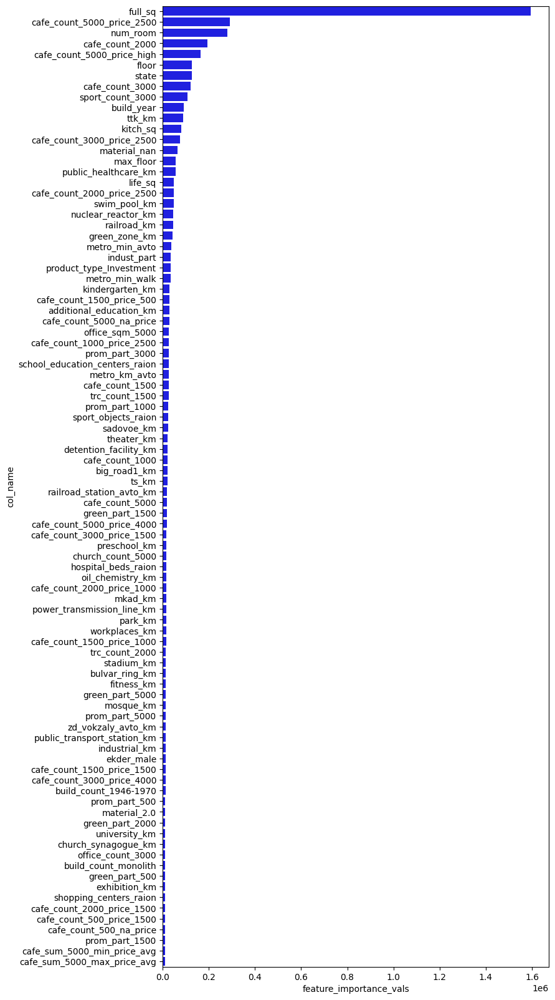

In [ ]:
rmsles = np.array(rmsles)
print(rmsles)

for features in most_important_features:
    display(features.head(10))

limit = 90
for feats in most_important_features:
    plt.figure(figsize=(8, 20))
    sns.barplot(x="feature_importance_vals", y="col_name", data=feats.iloc[:limit],
            color="b")

# Choosing Top K features

In [ ]:
from tqdm import tqdm

In [ ]:
most_important_features_ = most_important_features[0]

step = 5
limit = 151
start = 10
features = most_important_features_.values[:, 0]
# features = most_important_features.values[:, 0]
rmsles = {}
for i in tqdm(range(start, limit, step), desc="Num Features"):
    print(f"Training for {i} features")
    model =  XGBRegressor(
                    # verbosity=0,
                    device=xgb_params['device'],
                    objective=xgb_params['objective'],
                    eval_metric=xgb_params['eval_metric'],
                    enable_categorical=xgb_params['enable_categorical'],
                    early_stopping_rounds=xgb_params['early_stopping_rounds'],
                    n_jobs=xgb_params['n_jobs'],
                    booster='booster',

                    **best_params
                )
    
    # Train
    rmsles_, _ = cal_mean_errors(train_df, [model], features[:i], seed=seed)
    rmsles[i] = rmsles_  

Num Features:   0%|          | 0/88 [00:00<?, ?it/s]

Training for 10 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 15 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 20 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 25 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 30 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 35 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 40 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 45 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 50 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 55 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 60 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 65 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 70 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 75 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 80 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 85 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 90 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 95 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 100 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 105 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 110 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 115 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 120 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 125 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 130 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 135 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 140 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 145 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 150 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 155 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 160 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 165 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 170 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 175 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 180 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 185 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 190 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 195 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 200 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 205 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 210 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 215 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 220 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 225 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 230 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 235 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 240 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 245 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 250 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 255 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 260 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 265 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 270 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 275 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 280 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 285 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

Training for 290 features


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

KeyboardInterrupt: 

Text(0, 0.5, 'RMSE')

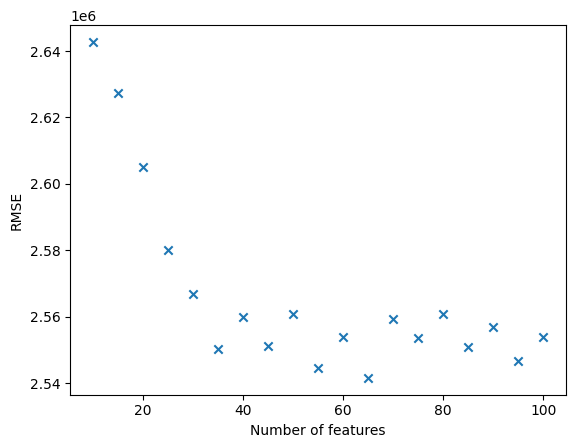

In [ ]:
plt.scatter(rmsles.keys(), rmsles.values(), marker='x')
plt.xlabel('Number of features')
plt.ylabel('RMSE')

In [ ]:
ordered_feats = sorted(rmsles.keys(), key=rmsles.get)
ordered_feats

[65, 55, 95, 35, 85, 45, 75, 100, 60, 90, 70, 40, 80, 50, 30, 25, 20, 15, 10]

In [ ]:
# feats_to_use = most_important_features_[:ordered_feats[len(ordered_feats)//2]].values[:, 0].tolist()
feats_to_use = most_important_features_[:ordered_feats[0]].values[:, 0].tolist()
feats_to_use


['full_sq',
 'cafe_count_5000_price_2500',
 'num_room',
 'cafe_count_2000',
 'cafe_count_5000_price_high',
 'floor',
 'state',
 'cafe_count_3000',
 'sport_count_3000',
 'build_year',
 'ttk_km',
 'kitch_sq',
 'cafe_count_3000_price_2500',
 'material_nan',
 'max_floor',
 'public_healthcare_km',
 'life_sq',
 'cafe_count_2000_price_2500',
 'swim_pool_km',
 'nuclear_reactor_km',
 'railroad_km',
 'green_zone_km',
 'metro_min_avto',
 'indust_part',
 'product_type_Investment',
 'metro_min_walk',
 'kindergarten_km',
 'cafe_count_1500_price_500',
 'additional_education_km',
 'cafe_count_5000_na_price',
 'office_sqm_5000',
 'cafe_count_1000_price_2500',
 'prom_part_3000',
 'school_education_centers_raion',
 'metro_km_avto',
 'cafe_count_1500',
 'trc_count_1500',
 'prom_part_1000',
 'sport_objects_raion',
 'sadovoe_km',
 'theater_km',
 'detention_facility_km',
 'cafe_count_1000',
 'big_road1_km',
 'ts_km',
 'railroad_station_avto_km',
 'cafe_count_5000',
 'green_part_1500',
 'cafe_count_5000_price

# Predicting

In [77]:
def train(X, y, evalset=None):    
    model =  XGBRegressor(
                    # verbosity=0,
                    device=xgb_params['device'],
                    objective=xgb_params['objective'],
                    eval_metric=xgb_params['eval_metric'],
                    enable_categorical=xgb_params['enable_categorical'],
                    early_stopping_rounds=xgb_params['early_stopping_rounds'],
                    n_jobs=xgb_params['n_jobs'],
                    booster='dart',

                    **best_params
                )
    if not evalset:
        model.fit(X, y, verbose=True)
    else:
        model.fit(X, y, eval_set=evalset, verbose=True)

    return model

def find_best_model(processed_df):
    # Return best model from kfolds
    best_model = None
    min_loss = float('inf')
    to_return = []
    cv = KFold(n_splits=10, shuffle=True, random_state=42)
    for fold, (train_idx, test_idx) in enumerate(cv.split(processed_df)):
        X_train = processed_df.iloc[train_idx]
        y_train = X_train["price_doc"]
        X_train.drop(["price_doc"], axis=1, inplace=True)

        X_val = processed_df.iloc[test_idx]
        y_val = X_val["price_doc"]
        X_val.drop(["price_doc"], axis=1, inplace=True)

        evalset = [(X_val, y_val)]
        model = train(X_train, y_train, evalset)

        pred = model.predict(X_val)
        loss = mean_squared_error(y_val, pred, squared=False)
        
        to_return.append((model, loss))
    
    return to_return

In [78]:
processed_train = pd.read_csv('processed/processed_train_2.csv')

In [79]:
models = find_best_model(processed_train)#[feats_to_use+['price_doc']])
sorted_models = sorted(models, key=lambda x: x[1])


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.61042
[1]	validation_0-rmsle:0.59530
[2]	validation_0-rmsle:0.58115
[3]	validation_0-rmsle:0.57137
[4]	validation_0-rmsle:0.55836
[5]	validation_0-rmsle:0.55153
[6]	validation_0-rmsle:0.54673
[7]	validation_0-rmsle:0.53781
[8]	validation_0-rmsle:0.53396
[9]	validation_0-rmsle:0.52689
[10]	validation_0-rmsle:0.52074
[11]	validation_0-rmsle:0.51821
[12]	validation_0-rmsle:0.51308
[13]	validation_0-rmsle:0.50912
[14]	validation_0-rmsle:0.50840
[15]	validation_0-rmsle:0.50678
[16]	validation_0-rmsle:0.50545
[17]	validation_0-rmsle:0.50336
[18]	validation_0-rmsle:0.50264
[19]	validation_0-rmsle:0.50032
[20]	validation_0-rmsle:0.49876
[21]	validation_0-rmsle:0.49818
[22]	validation_0-rmsle:0.49746
[23]	validation_0-rmsle:0.49693
[24]	validation_0-rmsle:0.49525
[25]	validation_0-rmsle:0.49440
[26]	validation_0-rmsle:0.49273
[27]	validation_0-rmsle:0.49164
[28]	validation_0-rmsle:0.49078
[29]	validation_0-rmsle:0.49017
[30]	validation_0-rmsle:0.48890
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.59026
[1]	validation_0-rmsle:0.57423
[2]	validation_0-rmsle:0.56014


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[3]	validation_0-rmsle:0.54921
[4]	validation_0-rmsle:0.53598
[5]	validation_0-rmsle:0.52864
[6]	validation_0-rmsle:0.52275
[7]	validation_0-rmsle:0.51369
[8]	validation_0-rmsle:0.50947
[9]	validation_0-rmsle:0.50224
[10]	validation_0-rmsle:0.49653
[11]	validation_0-rmsle:0.49323
[12]	validation_0-rmsle:0.48848
[13]	validation_0-rmsle:0.48441
[14]	validation_0-rmsle:0.48378
[15]	validation_0-rmsle:0.48170
[16]	validation_0-rmsle:0.48013
[17]	validation_0-rmsle:0.47801
[18]	validation_0-rmsle:0.47736
[19]	validation_0-rmsle:0.47495
[20]	validation_0-rmsle:0.47343
[21]	validation_0-rmsle:0.47266
[22]	validation_0-rmsle:0.47145
[23]	validation_0-rmsle:0.47081
[24]	validation_0-rmsle:0.46906
[25]	validation_0-rmsle:0.46802
[26]	validation_0-rmsle:0.46648
[27]	validation_0-rmsle:0.46569
[28]	validation_0-rmsle:0.46503
[29]	validation_0-rmsle:0.46450
[30]	validation_0-rmsle:0.46353
[31]	validation_0-rmsle:0.46266
[32]	validation_0-rmsle:0.46194
[33]	validation_0-rmsle:0.46165
[34]	validation

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.58747
[1]	validation_0-rmsle:0.57242


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[2]	validation_0-rmsle:0.55805
[3]	validation_0-rmsle:0.54854
[4]	validation_0-rmsle:0.53502
[5]	validation_0-rmsle:0.52789
[6]	validation_0-rmsle:0.52250
[7]	validation_0-rmsle:0.51368
[8]	validation_0-rmsle:0.50972
[9]	validation_0-rmsle:0.50271
[10]	validation_0-rmsle:0.49691
[11]	validation_0-rmsle:0.49388
[12]	validation_0-rmsle:0.48913
[13]	validation_0-rmsle:0.48506
[14]	validation_0-rmsle:0.48435
[15]	validation_0-rmsle:0.48227
[16]	validation_0-rmsle:0.48095
[17]	validation_0-rmsle:0.47924
[18]	validation_0-rmsle:0.47850
[19]	validation_0-rmsle:0.47624
[20]	validation_0-rmsle:0.47470
[21]	validation_0-rmsle:0.47389
[22]	validation_0-rmsle:0.47283
[23]	validation_0-rmsle:0.47217
[24]	validation_0-rmsle:0.47041
[25]	validation_0-rmsle:0.46962
[26]	validation_0-rmsle:0.46792
[27]	validation_0-rmsle:0.46695
[28]	validation_0-rmsle:0.46632
[29]	validation_0-rmsle:0.46588
[30]	validation_0-rmsle:0.46498
[31]	validation_0-rmsle:0.46400
[32]	validation_0-rmsle:0.46322
[33]	validation_

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.59915
[1]	validation_0-rmsle:0.58399
[2]	validation_0-rmsle:0.56974


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[3]	validation_0-rmsle:0.55915
[4]	validation_0-rmsle:0.54657
[5]	validation_0-rmsle:0.53906
[6]	validation_0-rmsle:0.53423
[7]	validation_0-rmsle:0.52595
[8]	validation_0-rmsle:0.52132
[9]	validation_0-rmsle:0.51487
[10]	validation_0-rmsle:0.50961
[11]	validation_0-rmsle:0.50683
[12]	validation_0-rmsle:0.50262
[13]	validation_0-rmsle:0.49870
[14]	validation_0-rmsle:0.49799
[15]	validation_0-rmsle:0.49574
[16]	validation_0-rmsle:0.49410
[17]	validation_0-rmsle:0.49277
[18]	validation_0-rmsle:0.49231
[19]	validation_0-rmsle:0.48999
[20]	validation_0-rmsle:0.48873
[21]	validation_0-rmsle:0.48806
[22]	validation_0-rmsle:0.48689
[23]	validation_0-rmsle:0.48661
[24]	validation_0-rmsle:0.48509
[25]	validation_0-rmsle:0.48410
[26]	validation_0-rmsle:0.48250
[27]	validation_0-rmsle:0.48136
[28]	validation_0-rmsle:0.48058
[29]	validation_0-rmsle:0.48004
[30]	validation_0-rmsle:0.47901
[31]	validation_0-rmsle:0.47808
[32]	validation_0-rmsle:0.47742
[33]	validation_0-rmsle:0.47712
[34]	validation

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.60215
[1]	validation_0-rmsle:0.58645
[2]	validation_0-rmsle:0.57106
[3]	validation_0-rmsle:0.56070
[4]	validation_0-rmsle:0.54653
[5]	validation_0-rmsle:0.53937
[6]	validation_0-rmsle:0.53363
[7]	validation_0-rmsle:0.52371
[8]	validation_0-rmsle:0.51981
[9]	validation_0-rmsle:0.51199
[10]	validation_0-rmsle:0.50561
[11]	validation_0-rmsle:0.50255
[12]	validation_0-rmsle:0.49727
[13]	validation_0-rmsle:0.49297
[14]	validation_0-rmsle:0.49223
[15]	validation_0-rmsle:0.49027
[16]	validation_0-rmsle:0.48872
[17]	validation_0-rmsle:0.48623
[18]	validation_0-rmsle:0.48580
[19]	validation_0-rmsle:0.48320
[20]	validation_0-rmsle:0.48174
[21]	validation_0-rmsle:0.48057
[22]	validation_0-rmsle:0.47950
[23]	validation_0-rmsle:0.47912
[24]	validation_0-rmsle:0.47718
[25]	validation_0-rmsle:0.47665
[26]	validation_0-rmsle:0.47464
[27]	validation_0-rmsle:0.47362
[28]	validation_0-rmsle:0.47290
[29]	validation_0-rmsle:0.47227
[30]	validation_0-rmsle:0.47116
[31]	validation_0-

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.60576
[1]	validation_0-rmsle:0.58934
[2]	validation_0-rmsle:0.57392


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[3]	validation_0-rmsle:0.56258
[4]	validation_0-rmsle:0.54934
[5]	validation_0-rmsle:0.54204
[6]	validation_0-rmsle:0.53569
[7]	validation_0-rmsle:0.52664
[8]	validation_0-rmsle:0.52224
[9]	validation_0-rmsle:0.51530
[10]	validation_0-rmsle:0.50935
[11]	validation_0-rmsle:0.50652
[12]	validation_0-rmsle:0.50183
[13]	validation_0-rmsle:0.49778
[14]	validation_0-rmsle:0.49712
[15]	validation_0-rmsle:0.49518
[16]	validation_0-rmsle:0.49351
[17]	validation_0-rmsle:0.49148
[18]	validation_0-rmsle:0.49048
[19]	validation_0-rmsle:0.48812
[20]	validation_0-rmsle:0.48634
[21]	validation_0-rmsle:0.48539
[22]	validation_0-rmsle:0.48436
[23]	validation_0-rmsle:0.48374
[24]	validation_0-rmsle:0.48215
[25]	validation_0-rmsle:0.48134
[26]	validation_0-rmsle:0.47972
[27]	validation_0-rmsle:0.47881
[28]	validation_0-rmsle:0.47801
[29]	validation_0-rmsle:0.47739
[30]	validation_0-rmsle:0.47625
[31]	validation_0-rmsle:0.47537
[32]	validation_0-rmsle:0.47448
[33]	validation_0-rmsle:0.47420
[34]	validation

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.60599
[1]	validation_0-rmsle:0.59125
[2]	validation_0-rmsle:0.57822


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[3]	validation_0-rmsle:0.56825
[4]	validation_0-rmsle:0.55670
[5]	validation_0-rmsle:0.54949
[6]	validation_0-rmsle:0.54462
[7]	validation_0-rmsle:0.53720
[8]	validation_0-rmsle:0.53300
[9]	validation_0-rmsle:0.52730
[10]	validation_0-rmsle:0.52231
[11]	validation_0-rmsle:0.51930
[12]	validation_0-rmsle:0.51573
[13]	validation_0-rmsle:0.51282
[14]	validation_0-rmsle:0.51200
[15]	validation_0-rmsle:0.51029
[16]	validation_0-rmsle:0.50881
[17]	validation_0-rmsle:0.50720
[18]	validation_0-rmsle:0.50671
[19]	validation_0-rmsle:0.50503
[20]	validation_0-rmsle:0.50381
[21]	validation_0-rmsle:0.50301
[22]	validation_0-rmsle:0.50192
[23]	validation_0-rmsle:0.50151
[24]	validation_0-rmsle:0.50025
[25]	validation_0-rmsle:0.49945
[26]	validation_0-rmsle:0.49849
[27]	validation_0-rmsle:0.49780
[28]	validation_0-rmsle:0.49729
[29]	validation_0-rmsle:0.49700
[30]	validation_0-rmsle:0.49626
[31]	validation_0-rmsle:0.49579
[32]	validation_0-rmsle:0.49510
[33]	validation_0-rmsle:0.49489
[34]	validation

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.60460
[1]	validation_0-rmsle:0.59019


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[2]	validation_0-rmsle:0.57753
[3]	validation_0-rmsle:0.56848
[4]	validation_0-rmsle:0.55735
[5]	validation_0-rmsle:0.55147
[6]	validation_0-rmsle:0.54661
[7]	validation_0-rmsle:0.53866
[8]	validation_0-rmsle:0.53511
[9]	validation_0-rmsle:0.52885
[10]	validation_0-rmsle:0.52367
[11]	validation_0-rmsle:0.52097
[12]	validation_0-rmsle:0.51696
[13]	validation_0-rmsle:0.51355
[14]	validation_0-rmsle:0.51284
[15]	validation_0-rmsle:0.51104
[16]	validation_0-rmsle:0.50956
[17]	validation_0-rmsle:0.50795
[18]	validation_0-rmsle:0.50718
[19]	validation_0-rmsle:0.50524
[20]	validation_0-rmsle:0.50395
[21]	validation_0-rmsle:0.50328
[22]	validation_0-rmsle:0.50214
[23]	validation_0-rmsle:0.50185
[24]	validation_0-rmsle:0.50051
[25]	validation_0-rmsle:0.49977
[26]	validation_0-rmsle:0.49836
[27]	validation_0-rmsle:0.49763
[28]	validation_0-rmsle:0.49675
[29]	validation_0-rmsle:0.49639
[30]	validation_0-rmsle:0.49536
[31]	validation_0-rmsle:0.49458
[32]	validation_0-rmsle:0.49370
[33]	validation_

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.62666
[1]	validation_0-rmsle:0.61083


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[2]	validation_0-rmsle:0.59581
[3]	validation_0-rmsle:0.58581
[4]	validation_0-rmsle:0.57265
[5]	validation_0-rmsle:0.56485
[6]	validation_0-rmsle:0.55918
[7]	validation_0-rmsle:0.55037
[8]	validation_0-rmsle:0.54625
[9]	validation_0-rmsle:0.53959
[10]	validation_0-rmsle:0.53391
[11]	validation_0-rmsle:0.53094
[12]	validation_0-rmsle:0.52651
[13]	validation_0-rmsle:0.52274
[14]	validation_0-rmsle:0.52190
[15]	validation_0-rmsle:0.51985
[16]	validation_0-rmsle:0.51814
[17]	validation_0-rmsle:0.51624
[18]	validation_0-rmsle:0.51546
[19]	validation_0-rmsle:0.51315
[20]	validation_0-rmsle:0.51173
[21]	validation_0-rmsle:0.51079
[22]	validation_0-rmsle:0.50978
[23]	validation_0-rmsle:0.50939
[24]	validation_0-rmsle:0.50794
[25]	validation_0-rmsle:0.50734
[26]	validation_0-rmsle:0.50585
[27]	validation_0-rmsle:0.50509
[28]	validation_0-rmsle:0.50478
[29]	validation_0-rmsle:0.50428
[30]	validation_0-rmsle:0.50339
[31]	validation_0-rmsle:0.50258
[32]	validation_0-rmsle:0.50181
[33]	validation_

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spars

[0]	validation_0-rmsle:0.59942


is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.


[1]	validation_0-rmsle:0.58441
[2]	validation_0-rmsle:0.56992
[3]	validation_0-rmsle:0.55955
[4]	validation_0-rmsle:0.54683
[5]	validation_0-rmsle:0.53999
[6]	validation_0-rmsle:0.53421
[7]	validation_0-rmsle:0.52535
[8]	validation_0-rmsle:0.52107
[9]	validation_0-rmsle:0.51429
[10]	validation_0-rmsle:0.50842
[11]	validation_0-rmsle:0.50540
[12]	validation_0-rmsle:0.50087
[13]	validation_0-rmsle:0.49684
[14]	validation_0-rmsle:0.49604
[15]	validation_0-rmsle:0.49391
[16]	validation_0-rmsle:0.49216
[17]	validation_0-rmsle:0.49000
[18]	validation_0-rmsle:0.48906
[19]	validation_0-rmsle:0.48673
[20]	validation_0-rmsle:0.48528
[21]	validation_0-rmsle:0.48457
[22]	validation_0-rmsle:0.48366
[23]	validation_0-rmsle:0.48313
[24]	validation_0-rmsle:0.48108
[25]	validation_0-rmsle:0.48021
[26]	validation_0-rmsle:0.47863
[27]	validation_0-rmsle:0.47783
[28]	validation_0-rmsle:0.47716
[29]	validation_0-rmsle:0.47647
[30]	validation_0-rmsle:0.47535
[31]	validation_0-rmsle:0.47423
[32]	validation_0

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead


In [80]:
for m in sorted_models:
    print(m[1])

2259201.5469772317
2329754.8516866835
2334039.965041136
2375033.996480148
2429750.4379004575
2496422.1013536574
2537243.1359438333
2632182.0871452326
2730243.3821881646
3187863.470214834


In [81]:
median_model = sorted_models[len(sorted_models)//2][0]

In [82]:
test_path = 'processed/processed_test_2.csv'
test_id_path = '../../Dataset/test.csv/test.csv'
output_path = 'output/'
processed_test = pd.read_csv(test_path)
test_id = pd.read_csv(test_id_path)

In [83]:
for i, (model, _) in enumerate(sorted_models):
    pred = model.predict(processed_test.drop(columns=['id']))#[feats_to_use])
    # Save predictions
    prediction_df = pd.DataFrame({
        'id': test_id['id'],
        'price_doc': pred
    })

    prediction_df.to_csv(f'{output_path}/xgb_dart_pred_{i}.csv', index=False)

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated 